# Size

Original image size: (640, 480)


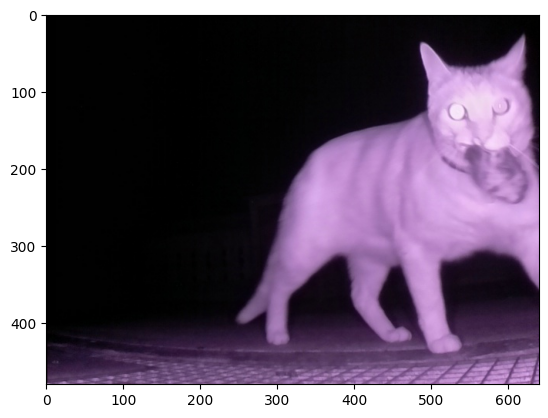

In [2]:
from PIL import Image
import matplotlib.pyplot as plt

# Load the image
image_path = r'C:/Users/mirela/Documents/gitRepos/CatWatcher/examples/2024_04_11_21_37_24_977125_cat_detected.jpg'
image = Image.open(image_path)

print(f'Original image size: {image.size}')
# properties info of the image: width: 640, height: 480

# show image
plt.imshow(image)


New image size: (480, 480)


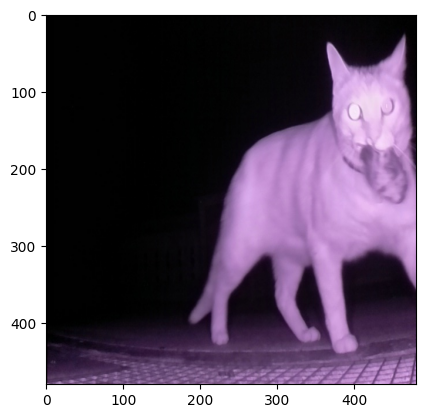

In [3]:
# resize the image to 480x480
new_image = image.resize((480, 480))
print(f'New image size: {new_image.size}')
# show image
plt.imshow(new_image)

New image size: (180, 180)


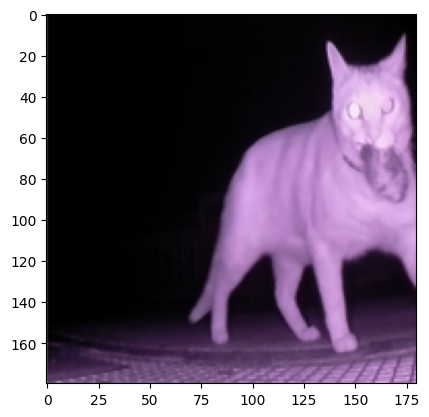

In [4]:
# resize the image to 180x180
new_image = image.resize((180, 180))
print(f'New image size: {new_image.size}')
# show image
plt.imshow(new_image)

New image size: (64, 64)


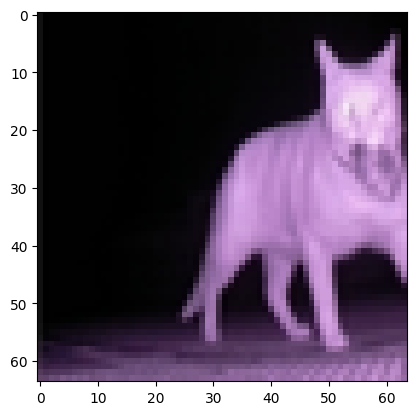

In [5]:
# resize the image
new_image = image.resize((64, 64))
print(f'New image size: {new_image.size}')
# show image
plt.imshow(new_image)

We should use at least 180x180!

# Color

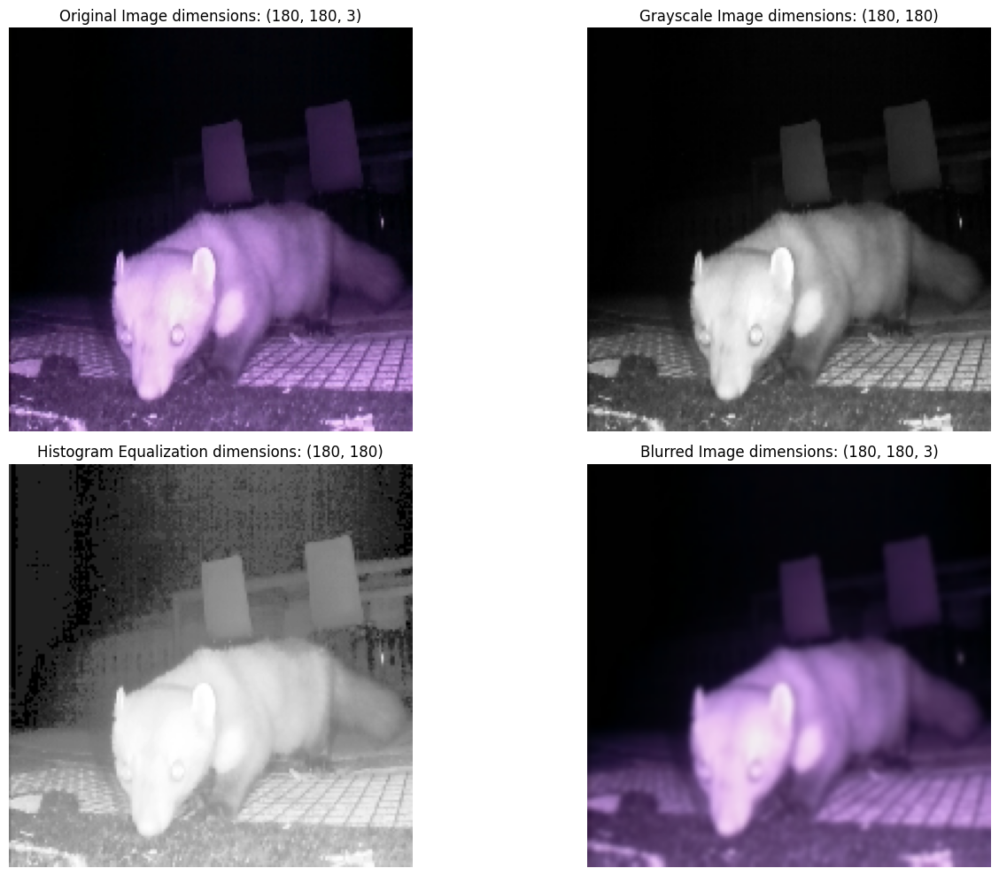

In [6]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.preprocessing import image

# Set the image dimensions
img_height, img_width = 180, 180

# Load an example image
img_path = 'C:\\Users\\mirela\\Documents\\gitRepos\\CatWatcher\\examples\\other\\2024_04_17_03_16_35_428391_cat_mouth_detected.jpg'
img = image.load_img(img_path, target_size=(img_height, img_width))
img_array = image.img_to_array(img)

# Convert to uint8
img_array = img_array.astype(np.uint8)

# Convert to grayscale
gray_img = cv2.cvtColor(img_array, cv2.COLOR_RGB2GRAY)

# Apply histogram equalization on grayscale
equalized_img = cv2.equalizeHist(gray_img)

# Apply Gaussian Blur on original image
blurred_img = cv2.GaussianBlur(img_array, (5, 5), 0)

# Display the images in a grid
plt.figure(figsize=(15, 10))

# Original Image
plt.subplot(2, 2, 1)
plt.title(f'Original Image dimensions: {img_array.shape}')
plt.imshow(img_array.astype('uint8'))
plt.axis('off')

# Grayscale Image
plt.subplot(2, 2, 2)
plt.title(f'Grayscale Image dimensions: {gray_img.shape}')
plt.imshow(gray_img, cmap='gray')
plt.axis('off')

# Histogram Equalization
plt.subplot(2, 2, 3)
plt.title(f'Histogram Equalization dimensions: {equalized_img.shape}')
plt.imshow(equalized_img, cmap='gray')
plt.axis('off')

# Blurred Image
plt.subplot(2, 2, 4)
plt.title(f'Blurred Image dimensions: {blurred_img.shape}')
plt.imshow(blurred_img.astype('uint8'))
plt.axis('off')

plt.tight_layout()
plt.show()


It might be useful to convert the images to grayscale, so the model does not learn random color changes (which happen due to different lighting conditions). Also, this would reduce computational cost!

Blurring might be useful as a data augmentation technique

# Contrast and Brightness Adjustments
Since the image appears to be affected by infrared night vision or low lighting, adjusting the contrast and brightness can help the model see the important features more clearly.
Alpha controls the contrast, and beta controls the brightness. Tweaking these values can help you make the cat more distinct in low-contrast environments (e.g., under infrared lighting or shadows).

In [ ]:
import cv2
import matplotlib.pyplot as plt

# load the image
path_rex = "C:/Users/mirela/Documents/gitRepos/CatWatcher/examples/2024_05_17_09_34_57_586252_cat_mouth_detected.jpg"
path_simba = "C:/Users/mirela/Documents/gitRepos/CatWatcher/examples/2024_04_11_21_37_24_977125_cat_detected.jpg"
path_hali = "C:/Users/mirela/Documents/gitRepos/CatWatcher/examples/test_approach_y/2024_06_06_05_08_04_082786_cat.jpg"

rex = image.load_img(path_rex, target_size=(img_height, img_width))
simba = image.load_img(path_simba, target_size=(img_height, img_width))
hali = image.load_img(path_hali, target_size=(img_height, img_width))

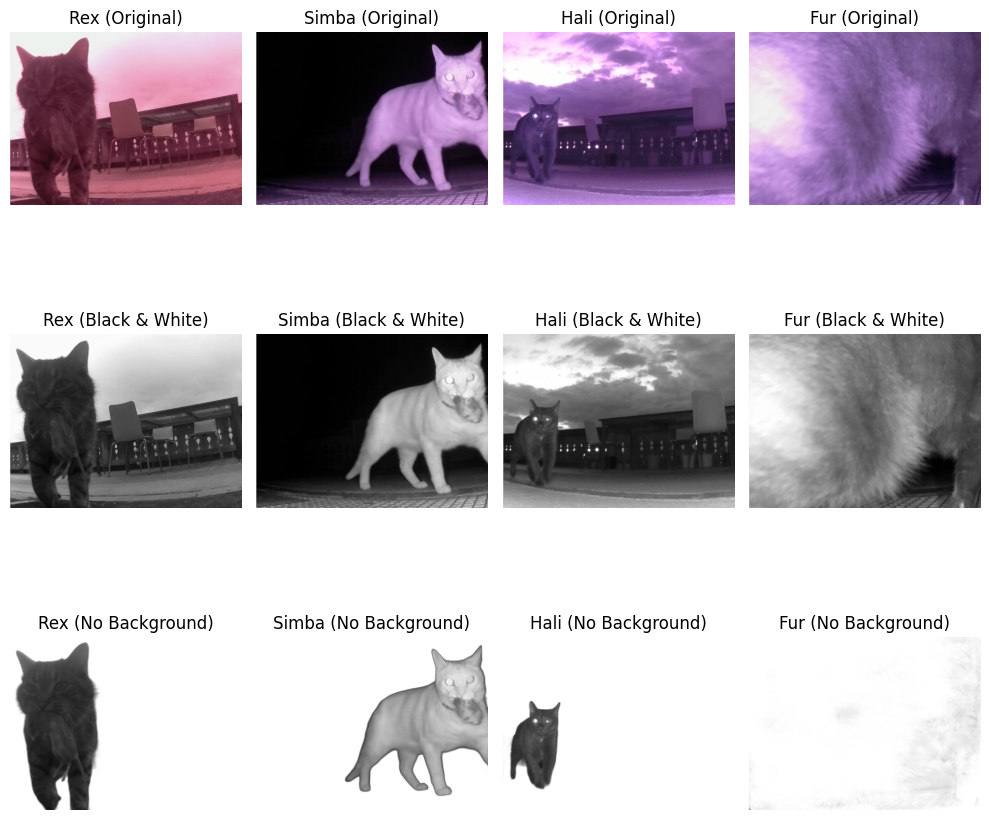

In [9]:
import rembg
import numpy as np
from PIL import Image
import cv2
import matplotlib.pyplot as plt

# Load the input images using PIL
path_rex = "C:/Users/mirela/Documents/gitRepos/CatWatcher/examples/2024_05_17_09_34_57_586252_cat_mouth_detected.jpg"
path_simba = "C:/Users/mirela/Documents/gitRepos/CatWatcher/examples/2024_04_11_21_37_24_977125_cat_detected.jpg"
path_hali = "C:/Users/mirela/Documents/gitRepos/CatWatcher/examples/test_approach_y/2024_06_06_05_08_04_082786_cat.jpg"
path_fur = "C:/Users/mirela/Documents/gitRepos/CatWatcher/cats_approach_training_2024_05_19/all/2023_12_21_00_54_51_336364_cat.jpg"

# Open the images
rex = Image.open(path_rex)
simba = Image.open(path_simba)
hali = Image.open(path_hali)
fur = Image.open(path_fur)

# Convert the images to numpy arrays
rex_array = np.array(rex)
simba_array = np.array(simba)
hali_array = np.array(hali)
fur_array = np.array(fur)

# convert to black and white
rex_bw = cv2.cvtColor(rex_array, cv2.COLOR_BGR2GRAY)
simba_bw = cv2.cvtColor(simba_array, cv2.COLOR_BGR2GRAY)
hali_bw = cv2.cvtColor(hali_array, cv2.COLOR_BGR2GRAY)
fur_bw = cv2.cvtColor(fur_array, cv2.COLOR_BGR2GRAY)

# Apply background removal using rembg
rex_no_bg = rembg.remove(rex_bw)
simba_no_bg = rembg.remove(simba_bw)
hali_no_bg = rembg.remove(hali_bw)
fur_no_bg = rembg.remove(fur_bw)

# Convert the output arrays back to PIL images
rex_no_bg_image = Image.fromarray(rex_no_bg)
simba_no_bg_image = Image.fromarray(simba_no_bg)
hali_no_bg_image = Image.fromarray(hali_no_bg)
fur_no_bg_image = Image.fromarray(fur_no_bg)

# Display the original and background-removed images side by side
plt.figure(figsize=(10, 10))

# Original images
plt.subplot(3, 4, 1)
plt.imshow(rex)
plt.title('Rex (Original)')
plt.axis('off')

plt.subplot(3, 4, 2)
plt.imshow(simba)
plt.title('Simba (Original)')
plt.axis('off')

plt.subplot(3, 4, 3)
plt.imshow(hali)
plt.title('Hali (Original)')
plt.axis('off')

plt.subplot(3, 4, 4)
plt.imshow(fur)
plt.title('Fur (Original)')
plt.axis('off')

# Black and white images
plt.subplot(3, 4, 5)
plt.imshow(rex_bw, cmap='gray')
plt.title('Rex (Black & White)')
plt.axis('off')

plt.subplot(3, 4, 6)
plt.imshow(simba_bw, cmap='gray')
plt.title('Simba (Black & White)')
plt.axis('off')

plt.subplot(3, 4, 7)
plt.imshow(hali_bw, cmap='gray')
plt.title('Hali (Black & White)')
plt.axis('off')

plt.subplot(3, 4, 8)
plt.imshow(fur_bw, cmap='gray')
plt.title('Fur (Black & White)')
plt.axis('off')

# Background-removed images
plt.subplot(3, 4, 9)
plt.imshow(rex_no_bg_image)
plt.title('Rex (No Background)')
plt.axis('off')

plt.subplot(3, 4, 10)
plt.imshow(simba_no_bg_image)
plt.title('Simba (No Background)')
plt.axis('off')

plt.subplot(3, 4, 11)
plt.imshow(hali_no_bg_image)
plt.title('Hali (No Background)')
plt.axis('off')

plt.subplot(3, 4, 12)
plt.imshow(fur_no_bg_image)
plt.title('Fur (No Background)')
plt.axis('off')

# Show the plot
plt.tight_layout()
plt.show()


Processing and displaying images...


  9%|▉         | 9/100 [00:06<01:02,  1.46it/s]

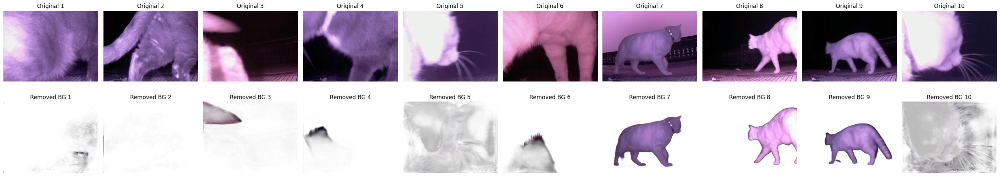

 19%|█▉        | 19/100 [00:13<00:54,  1.48it/s]

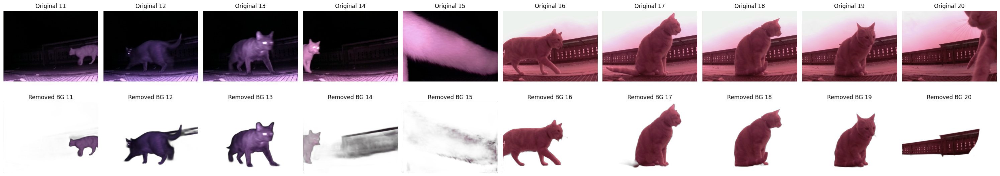

 29%|██▉       | 29/100 [00:21<00:48,  1.47it/s]

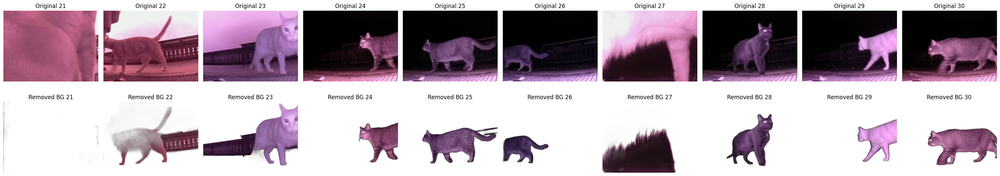

 39%|███▉      | 39/100 [00:28<00:41,  1.48it/s]

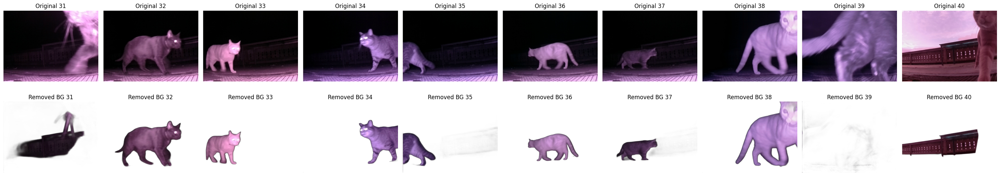

 49%|████▉     | 49/100 [00:36<00:34,  1.47it/s]

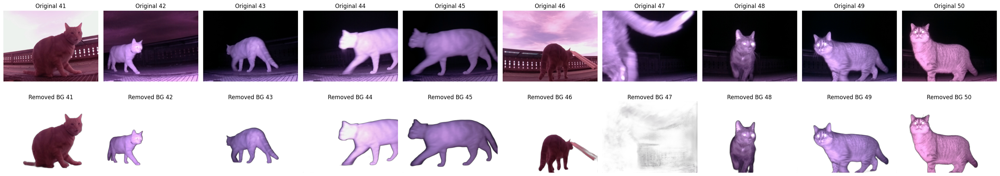

 59%|█████▉    | 59/100 [00:44<00:28,  1.46it/s]

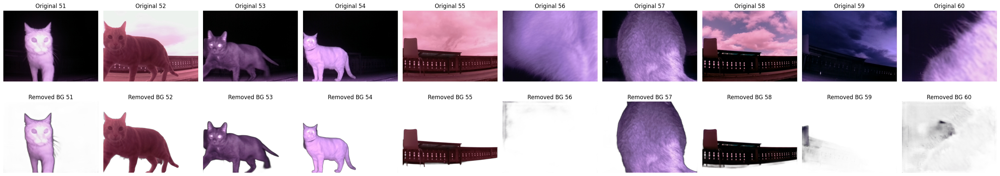

 69%|██████▉   | 69/100 [00:51<00:21,  1.47it/s]

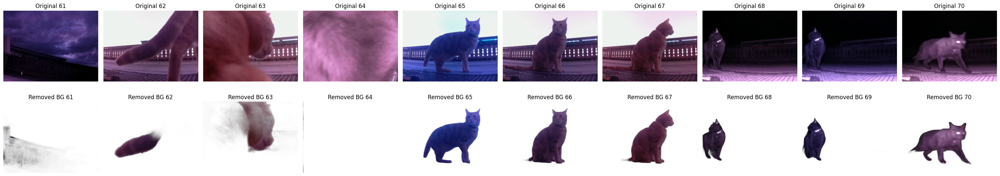

 79%|███████▉  | 79/100 [00:59<00:14,  1.47it/s]

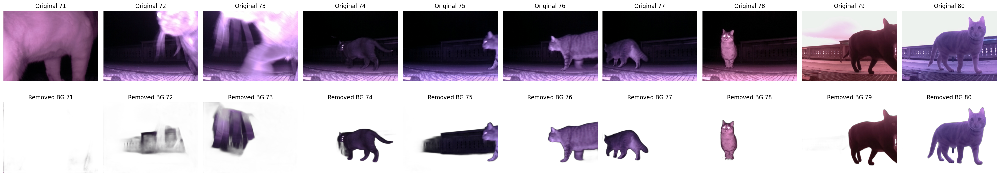

 89%|████████▉ | 89/100 [01:06<00:07,  1.46it/s]

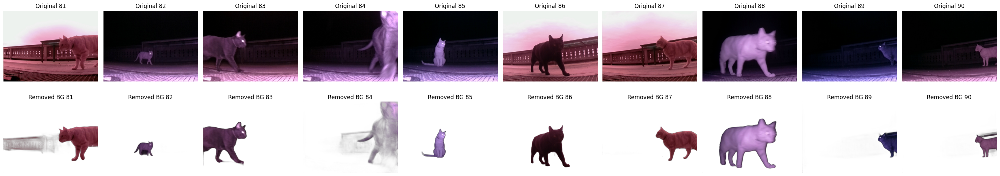

 99%|█████████▉| 99/100 [01:14<00:00,  1.46it/s]

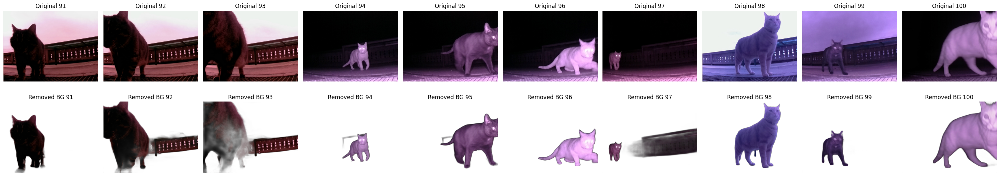

100%|██████████| 100/100 [01:15<00:00,  1.32it/s]


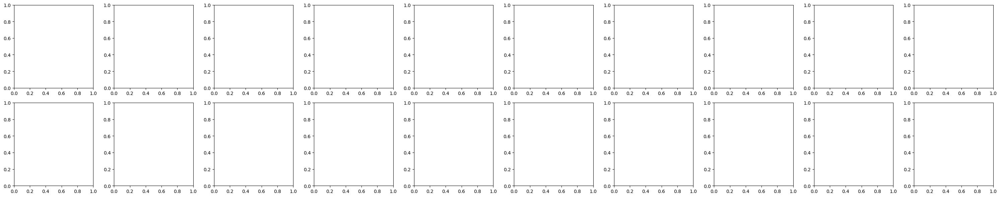

In [12]:
import os
from rembg import remove
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
from tqdm import tqdm

# Define input folder
input_folder = 'C:/Users/mirela/Desktop/cats_experiment/'    # Replace with your input folder path

# Process and display images in the notebook
print("Processing and displaying images...")

# Set the number of columns (adjust based on the width of your notebook)
num_columns = 10
fig, axs = plt.subplots(2, num_columns, figsize=(num_columns * 3, 6))

# Initialize a counter to track the image index
img_count = 0

for filename in tqdm(sorted(os.listdir(input_folder))):
    if filename.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp')):
        input_path = os.path.join(input_folder, filename)

        # Open the original image
        with Image.open(input_path) as img:
            img = img.convert('RGBA')  # Ensure image is in RGBA format

            # Remove the background using rembg
            bg_removed = remove(img)

            # Convert images to numpy arrays for plotting with matplotlib
            original_np = np.array(img)
            bg_removed_np = np.array(bg_removed)

            # Plot the original image
            axs[0, img_count % num_columns].imshow(original_np)
            axs[0, img_count % num_columns].axis('off')
            axs[0, img_count % num_columns].set_title(f'Original {img_count + 1}')

            # Plot the background-removed image
            axs[1, img_count % num_columns].imshow(bg_removed_np)
            axs[1, img_count % num_columns].axis('off')
            axs[1, img_count % num_columns].set_title(f'Removed BG {img_count + 1}')

            # Move to the next image
            img_count += 1

            # If we've plotted enough columns, create a new figure
            if img_count % num_columns == 0:
                plt.tight_layout()
                plt.show()

                # Create a new figure for the next set of images
                fig, axs = plt.subplots(2, num_columns, figsize=(num_columns * 3, 6))

# Show any remaining images in the final figure
plt.tight_layout()
plt.show()


Processing and displaying images...


  4%|▍         | 4/100 [00:02<01:04,  1.49it/s]

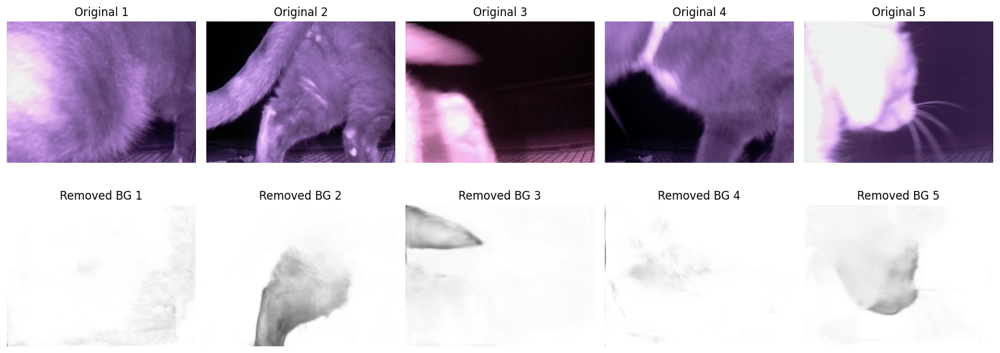

  9%|▉         | 9/100 [00:06<01:03,  1.43it/s]

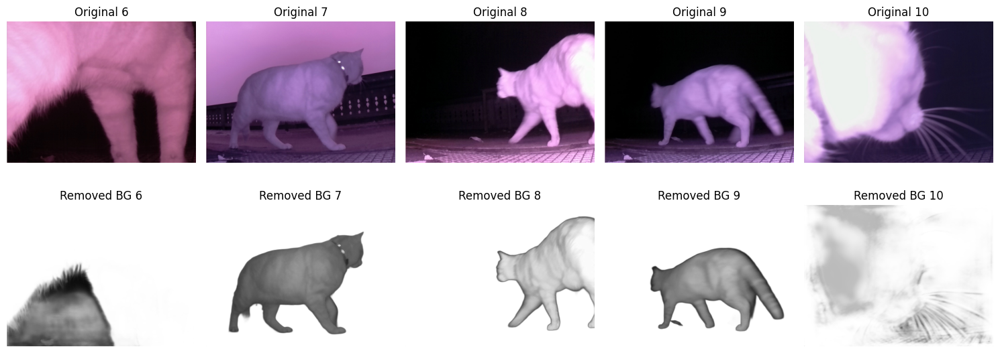

 14%|█▍        | 14/100 [00:10<01:00,  1.41it/s]

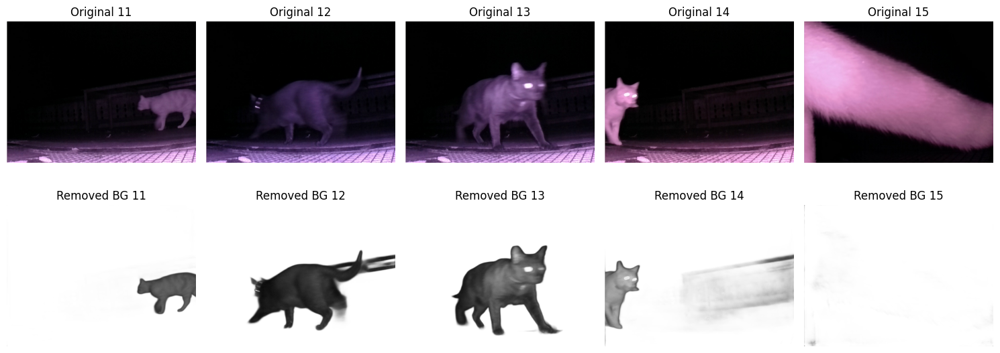

 19%|█▉        | 19/100 [00:13<00:56,  1.43it/s]

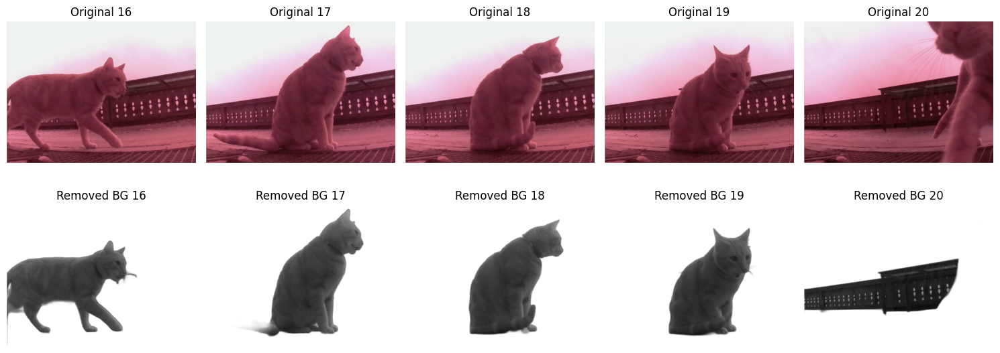

 24%|██▍       | 24/100 [00:17<00:53,  1.41it/s]

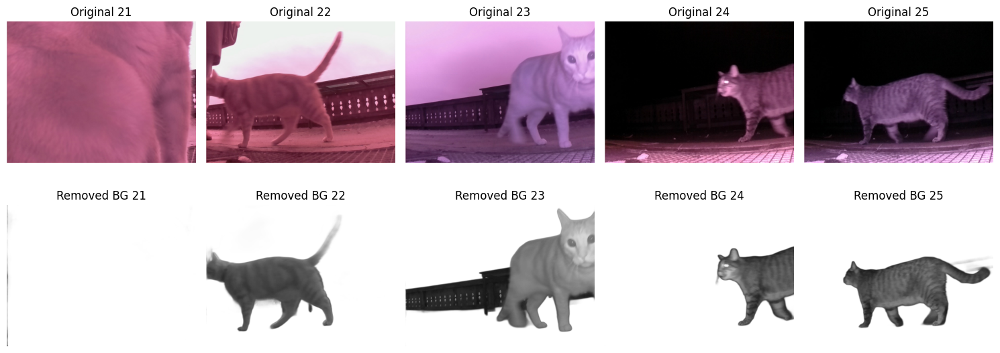

 29%|██▉       | 29/100 [00:21<00:50,  1.40it/s]

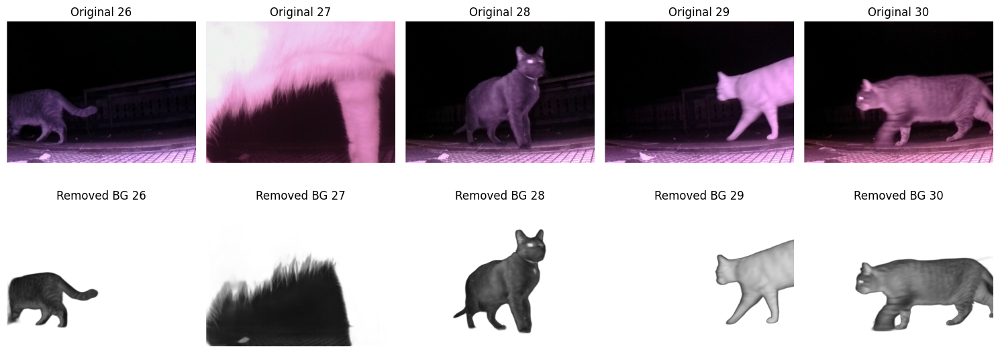

 34%|███▍      | 34/100 [00:25<00:46,  1.41it/s]

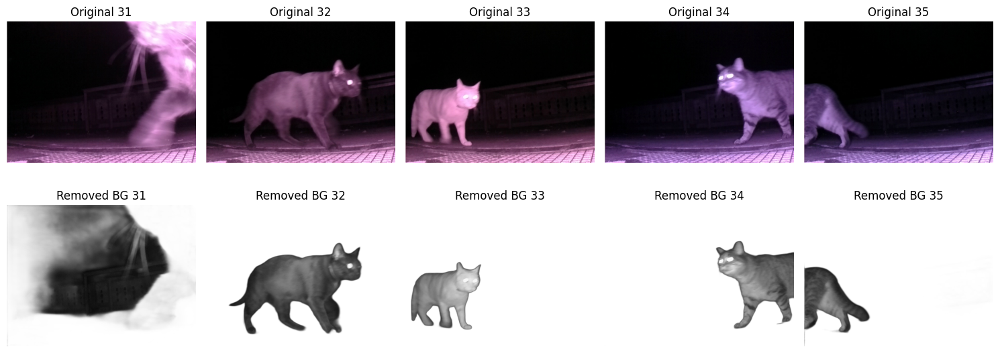

 39%|███▉      | 39/100 [00:29<00:42,  1.42it/s]

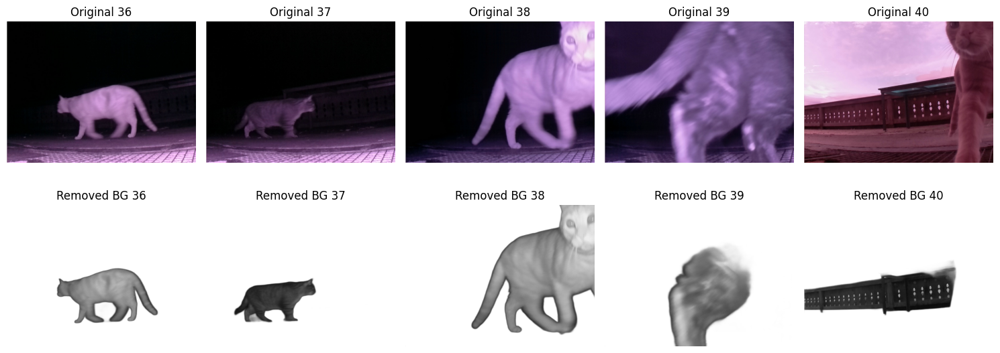

 44%|████▍     | 44/100 [00:32<00:39,  1.43it/s]

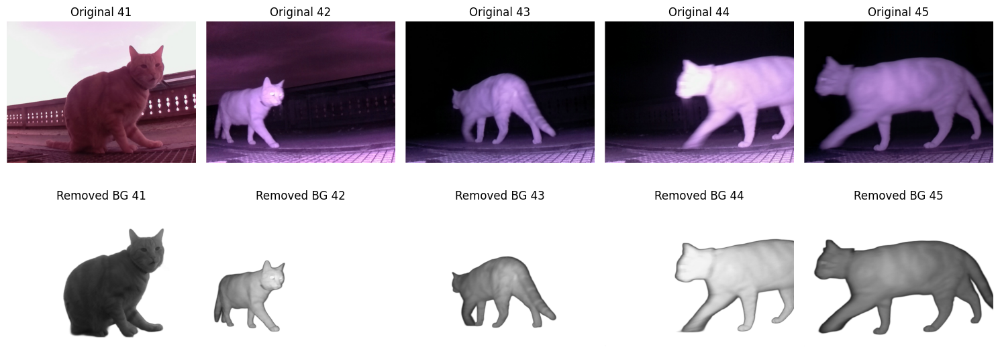

 49%|████▉     | 49/100 [00:36<00:35,  1.42it/s]

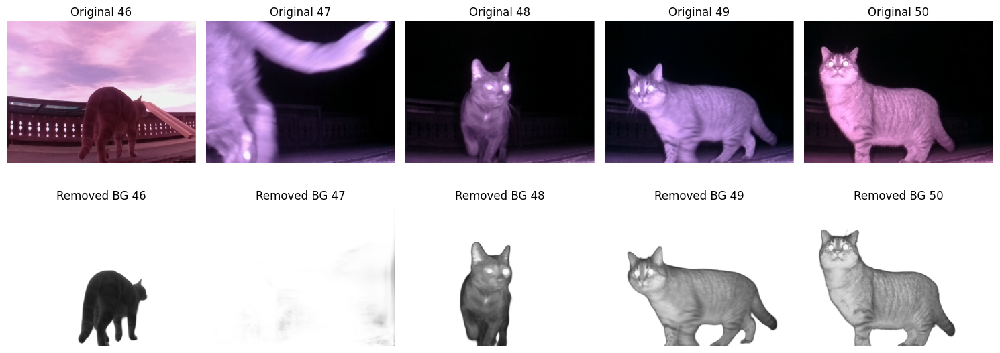

 54%|█████▍    | 54/100 [00:40<00:32,  1.42it/s]

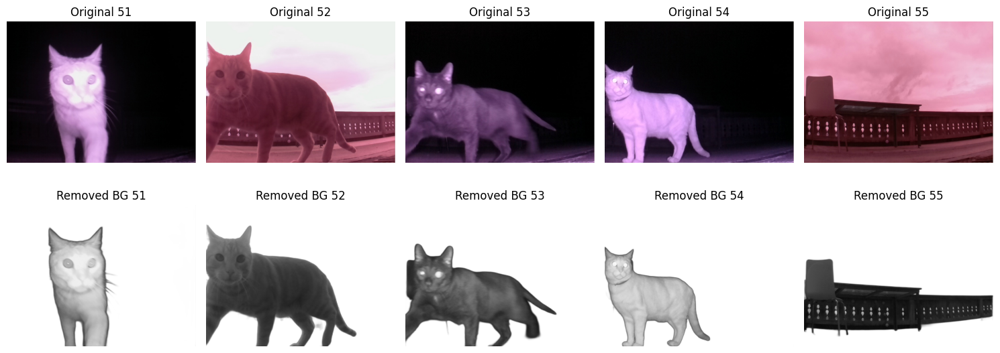

 59%|█████▉    | 59/100 [00:44<00:29,  1.40it/s]

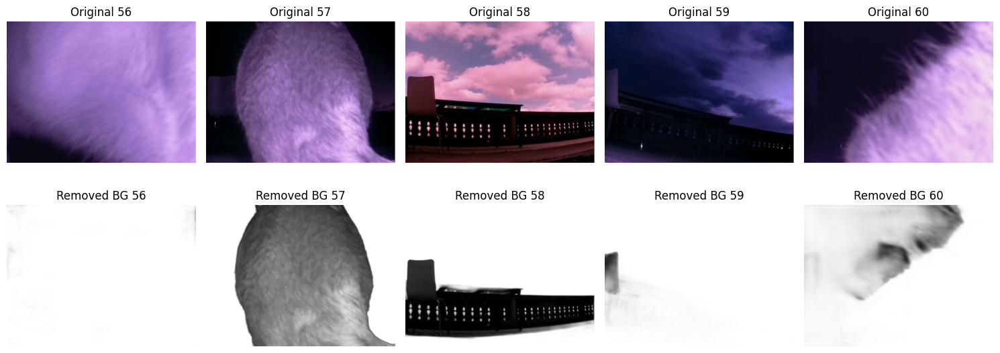

 64%|██████▍   | 64/100 [00:47<00:25,  1.42it/s]

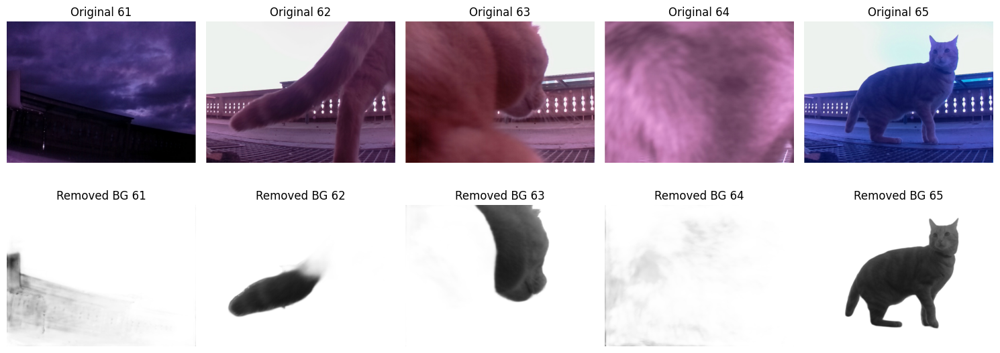

 69%|██████▉   | 69/100 [00:51<00:21,  1.42it/s]

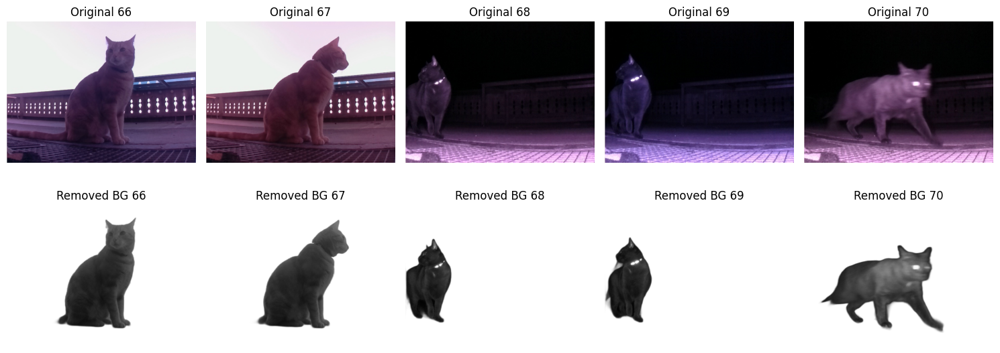

 74%|███████▍  | 74/100 [00:55<00:18,  1.41it/s]

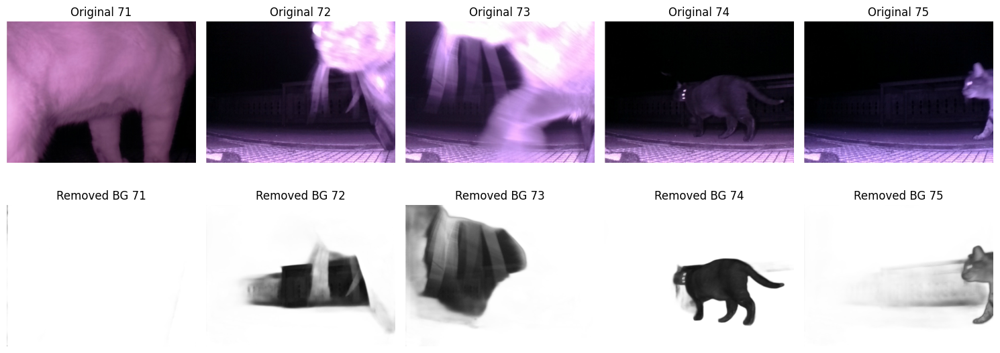

 79%|███████▉  | 79/100 [00:59<00:14,  1.40it/s]

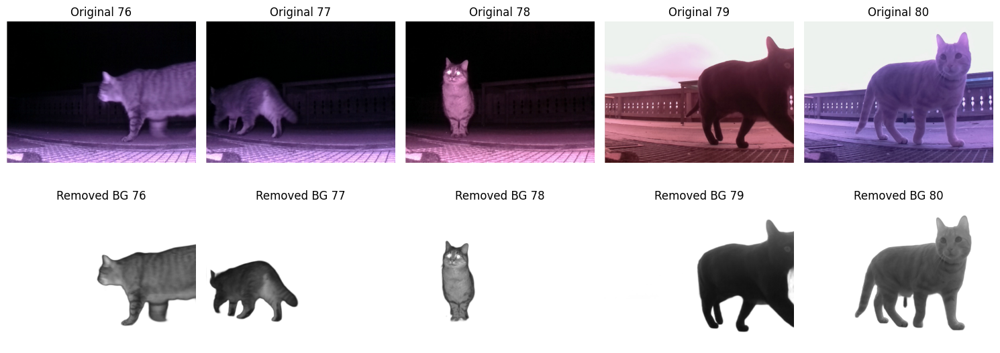

 84%|████████▍ | 84/100 [01:02<00:11,  1.41it/s]

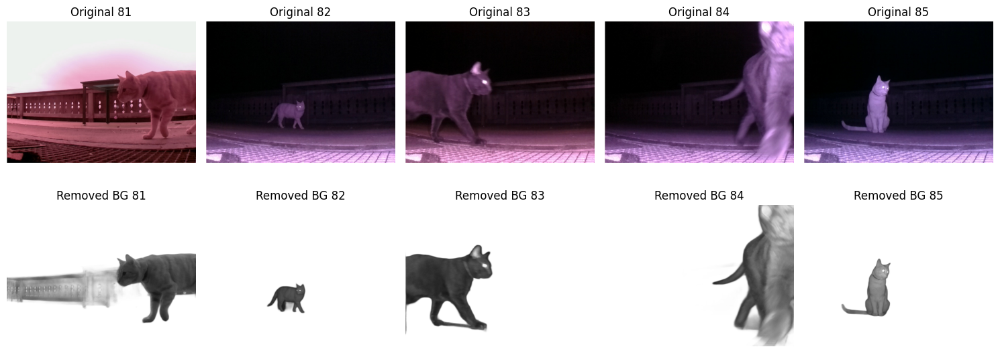

 89%|████████▉ | 89/100 [01:06<00:07,  1.42it/s]

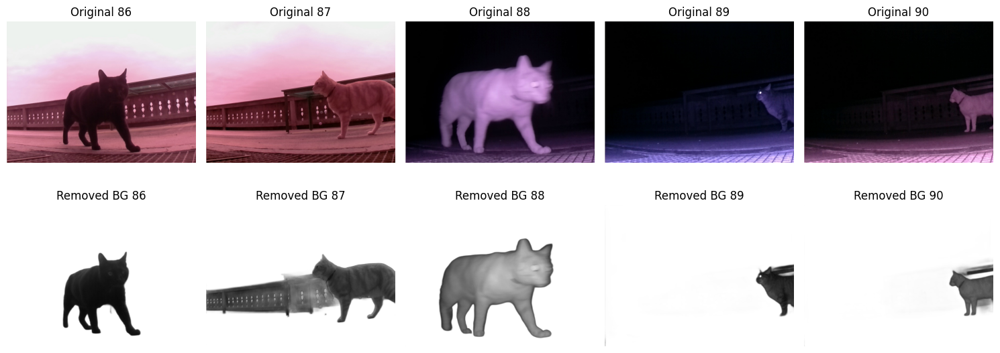

 94%|█████████▍| 94/100 [01:10<00:04,  1.40it/s]

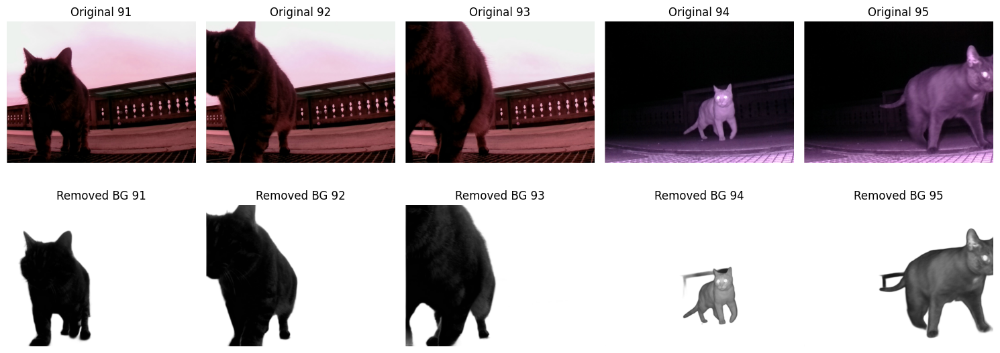

 99%|█████████▉| 99/100 [01:14<00:00,  1.41it/s]

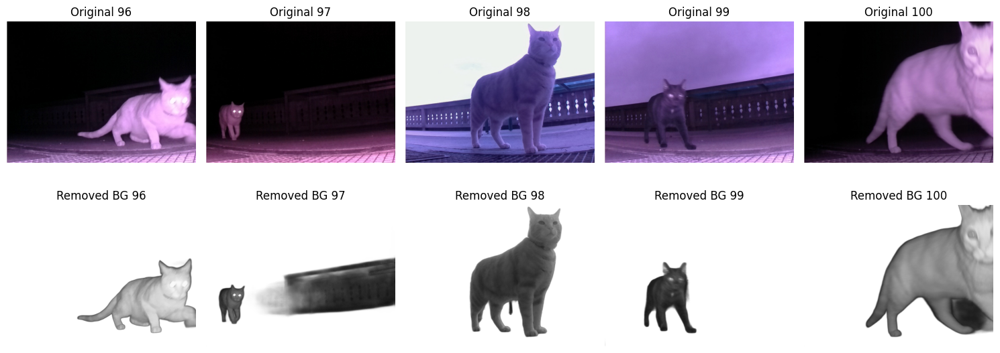

100%|██████████| 100/100 [01:15<00:00,  1.32it/s]


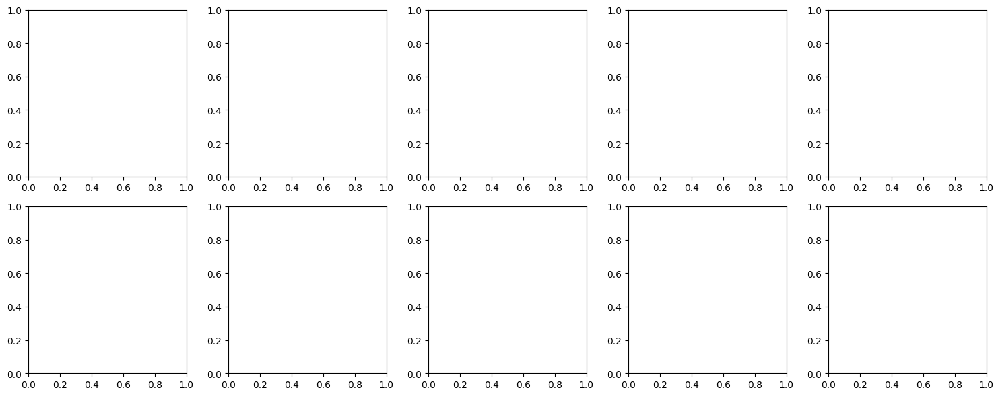

In [14]:

import os
from rembg import remove
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np
from tqdm import tqdm

# Define input folder
input_folder = 'C:/Users/mirela/Desktop/cats_experiment/'    # Replace with your input folder path

# Process and display images in the notebook
print("Processing and displaying images...")

# Set the number of columns (adjust based on the width of your notebook)
num_columns = 5
fig, axs = plt.subplots(2, num_columns, figsize=(num_columns * 3, 6))

# Initialize a counter to track the image index
img_count = 0

for filename in tqdm(sorted(os.listdir(input_folder))):
    if filename.lower().endswith(('.png', '.jpg', '.jpeg', '.bmp')):
        input_path = os.path.join(input_folder, filename)

        # Open the original image
        with Image.open(input_path) as img:
            img = img.convert('RGBA')  # Ensure image is in RGBA format

            # Convert the image to grayscale
            gray_img = img.convert('L').convert('RGBA')  # Convert to grayscale and back to RGBA for alpha channel

            # Remove the background using rembg
            bg_removed = remove(gray_img)

            # Convert images to numpy arrays for plotting with matplotlib
            original_np = np.array(img)
            bg_removed_np = np.array(bg_removed)

            # Plot the original image
            axs[0, img_count % num_columns].imshow(original_np)
            axs[0, img_count % num_columns].axis('off')
            axs[0, img_count % num_columns].set_title(f'Original {img_count + 1}')

            # Plot the background-removed image
            axs[1, img_count % num_columns].imshow(bg_removed_np)
            axs[1, img_count % num_columns].axis('off')
            axs[1, img_count % num_columns].set_title(f'Removed BG {img_count + 1}')

            # Move to the next image
            img_count += 1

            # If we've plotted enough columns, create a new figure
            if img_count % num_columns == 0:
                plt.tight_layout()
                plt.show()

                # Create a new figure for the next set of images
                fig, axs = plt.subplots(2, num_columns, figsize=(num_columns * 3, 6))

# Show any remaining images in the final figure
plt.tight_layout()
plt.show()
